# Shopee Code League - Product Detection

Date: 27 June 2020

In this competition, a multiple image classification model needs to be built. There are ~100k images within 42 different categories, including essential medical tools like masks, protective suits and thermometers, home & living products like air-conditioner and fashion products like T-shirts, rings, etc. For the data security purpose the category names will be desensitized. The evaluation metrics is top-1 accuracy.

# 1. Import Libraries

In [1]:
import os
import cv2
import glob
import warnings
warnings.filterwarnings('ignore')
import matplotlib.image as mpimg

import pandas as pd
import numpy as np
from PIL import Image
from IPython.display import Image as Image_Display
import seaborn as sns
import matplotlib.pyplot as plt
from keras.preprocessing.image import ImageDataGenerator, load_img
from tqdm import tqdm_notebook as tqdm
from torchvision.models import *
from sklearn.model_selection import train_test_split

from fastai.vision import *
from fastai.vision.models import *
from fastai.vision.learner import model_meta
from fastai.callbacks import * 

from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report

Using TensorFlow backend.


In [2]:
pd.set_option('display.max_columns', None)

# 2. Import Data

In [3]:
os.getcwd()
os.chdir("D:\\shopee-product-detection-dataset")

In [4]:
data_train = pd.read_csv("train.csv")
data_test = pd.read_csv("test.csv")

In [5]:
categories = pd.read_csv("Categories.csv")

In [6]:
# detection_list_1 = pd.read_excel("To_Remove.xlsx", sheet_name = "Sheet1")
# detection_list_2 = pd.read_excel("Shopee Product Detection List.xlsx", sheet_name = "13")
# detection_list_3 = pd.read_excel("Shopee Product Detection List.xlsx", sheet_name = "18")

In [7]:
# detection_list_1["Filename"] = detection_list_1["Filename"].apply(lambda x: x + ".jpg")

In [8]:
# detection_list = pd.concat([detection_list_1, detection_list_2], axis=0)
# detection_list = pd.concat([detection_list, detection_list_3], axis=0)

# 3. Set Path

In [9]:
data_train["category"] = data_train["category"].astype(str)
data_train["temp_category"] = data_train["category"].apply(lambda x: "0" + x if len(x)==1 else x)
# training set
image_path_list = []
for i in range(0, len(data_train)):
    image_path_list.append(os.path.join("train\\train", data_train["temp_category"][i], data_train["filename"][i]))
data_train["image_path"] = image_path_list

In [10]:
# testing set
image_path_list = []
for i in range(0, len(data_test)):
    image_path_list.append(os.path.join("test\\test", data_test["filename"][i]))
data_test["image_path"] = image_path_list

# 4. Exploratory Data Analysis

In [11]:
# Remove 1x1 image from train data
data_train = data_train.loc[data_train.filename != "8fe907b42fe7c29b6c43f67e3d68fe0a.jpg"]

In [12]:
data_train["category"] = data_train["category"].astype(int)

In [13]:
categories["Category"] = categories["Category"].astype(int)

In [14]:
dict_ = dict(categories.values.tolist())

In [15]:
data_train["cat_name"] = list(map(dict_.get, data_train["category"]))

In [16]:
def plot_class(cat):
    fetch = data_train.loc[data_train['cat_name']== dict_[cat]][:3]
    fig = plt.figure(figsize=(20,15))
    print("Category {}: {}".format(cat, dict_[cat]))
    for i , index in enumerate(fetch.index ,1):
        plt.subplot(1,3 ,i)
        img = mpimg.imread(data_train["image_path"][index])
        imgplot = plt.imshow(img)
        plt.xlabel(dict_[cat] + " (Index:" +str(index)+")" )
    plt.show()

Category 0: Dresses


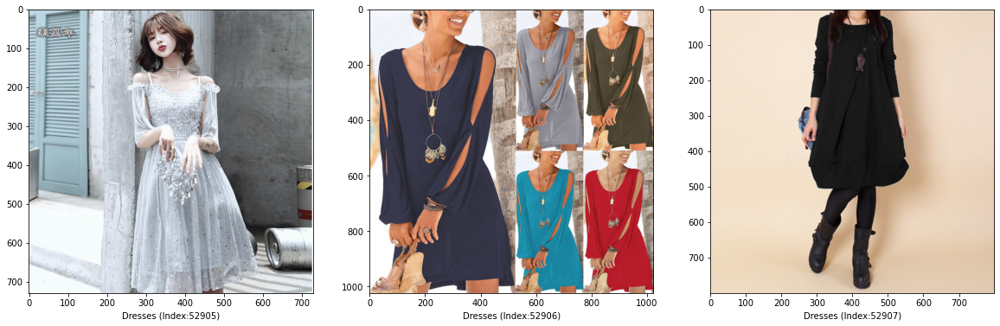

Category 1: Selma Maxi


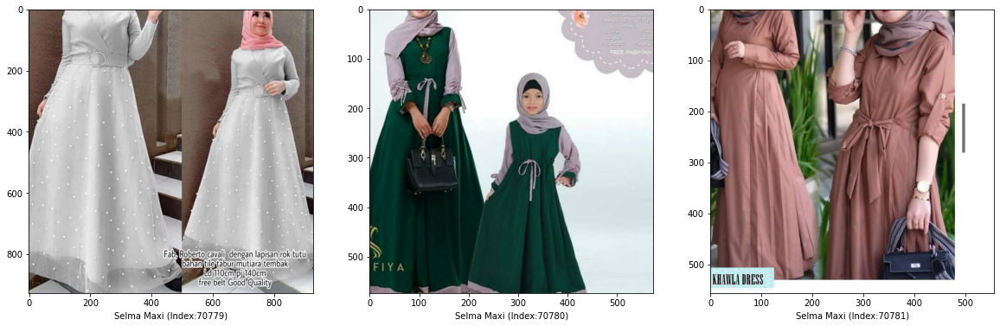

Category 2: T-Shirt


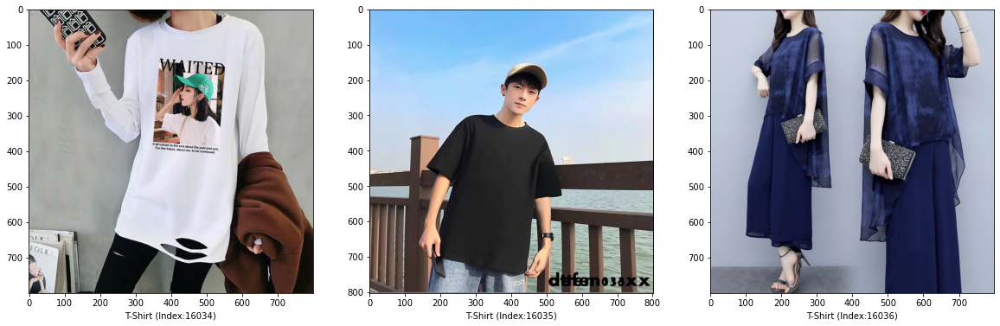

Category 3: Hoodie


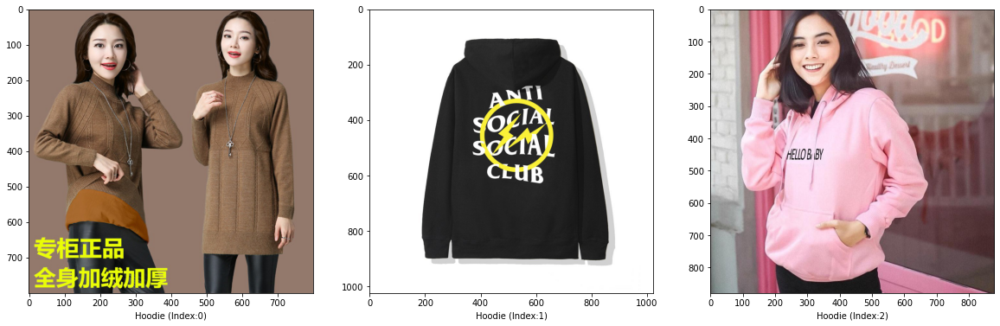

Category 4: Jeans


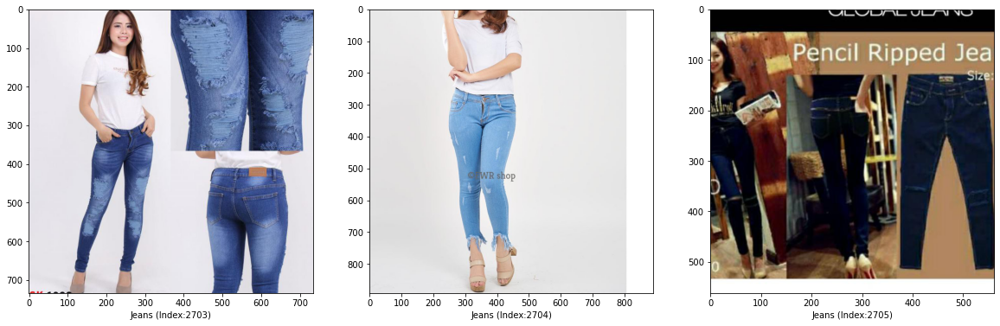

Category 5: Rings


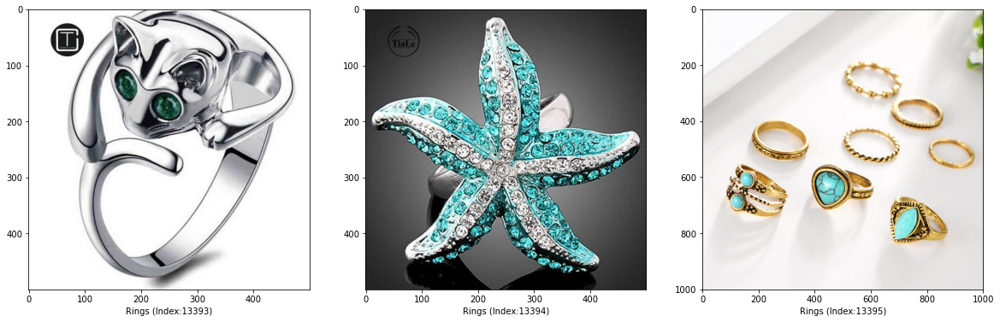

Category 6: Earrings


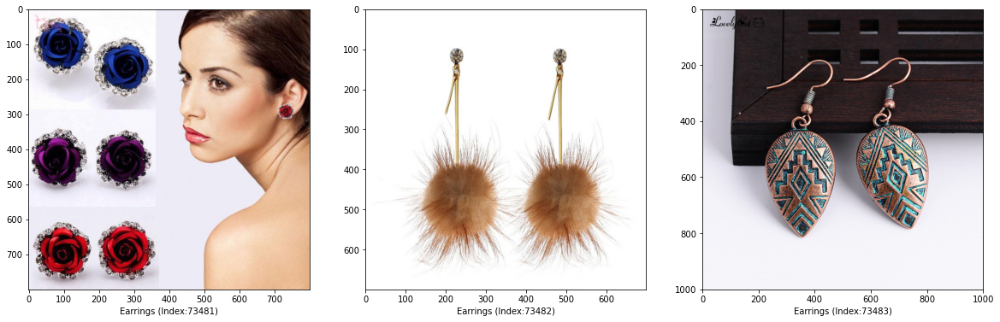

Category 7: Cap


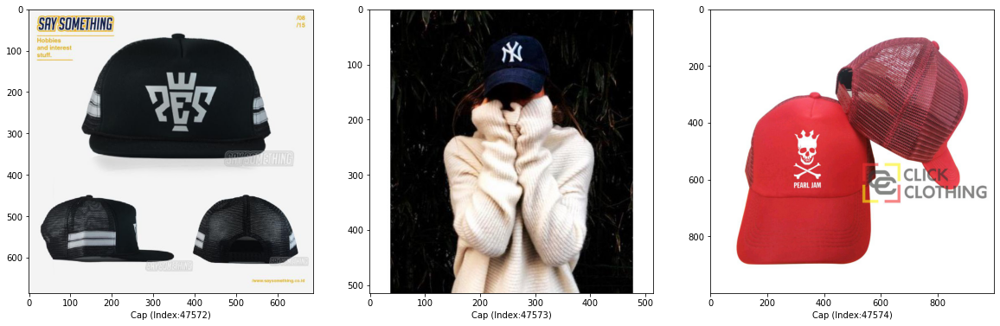

Category 8: Wallet


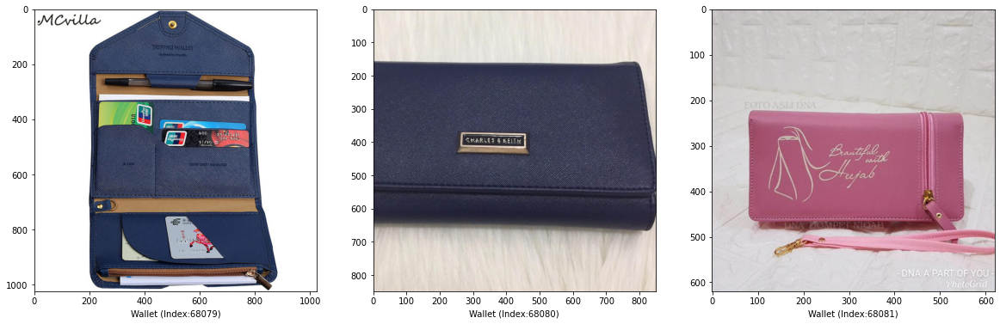

Category 9: Bag


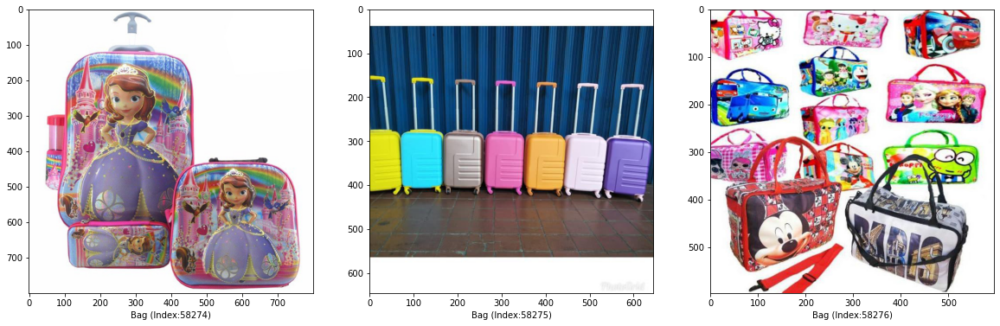

Category 10: Phone Case


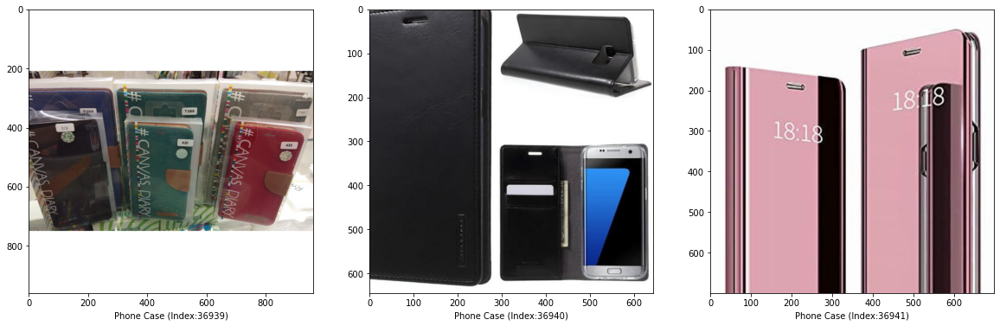

Category 11: Phone


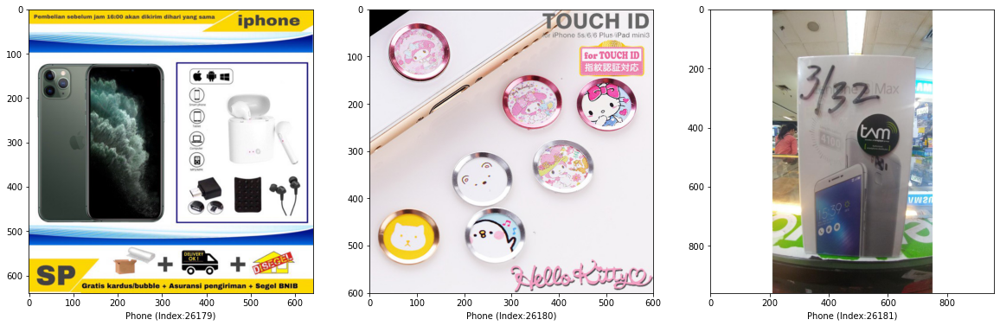

Category 12: Clock


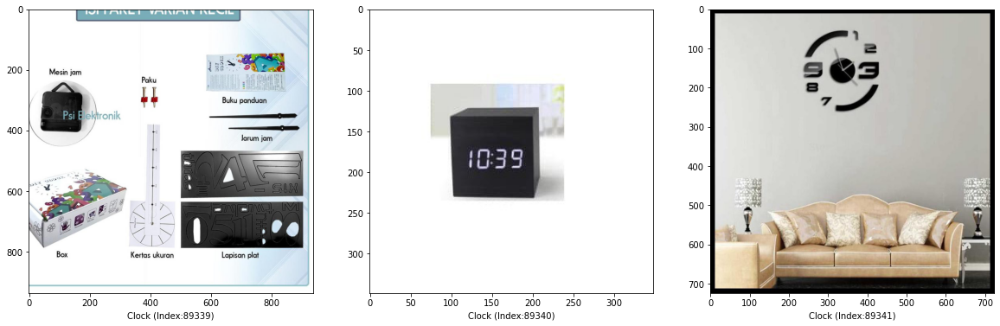

Category 13: Milk Bottle


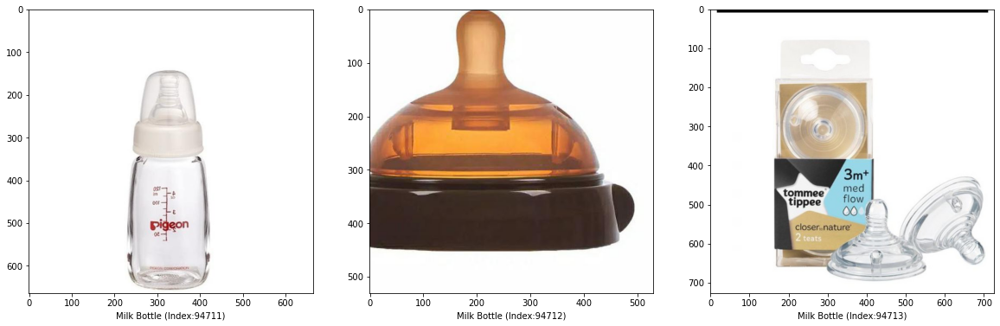

Category 14: Rice Cooker


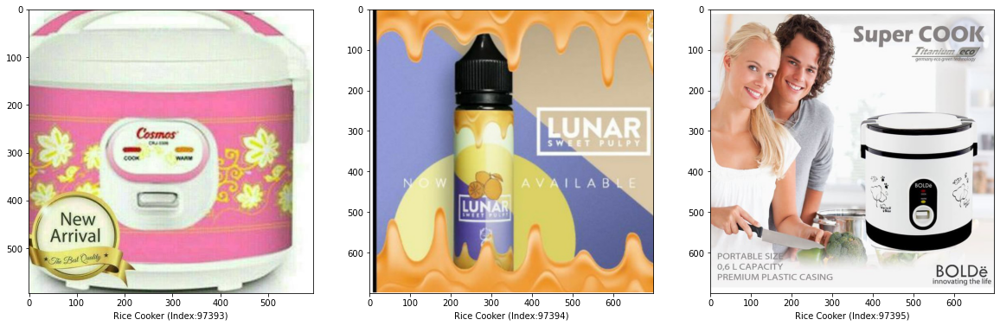

Category 15: Coffee Bean


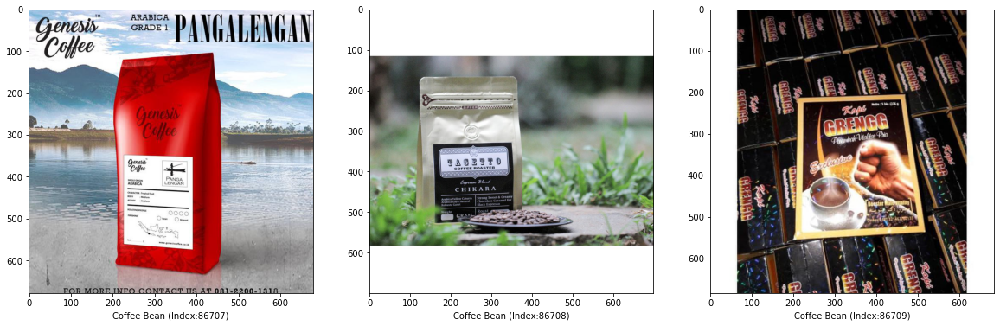

Category 16: Flats


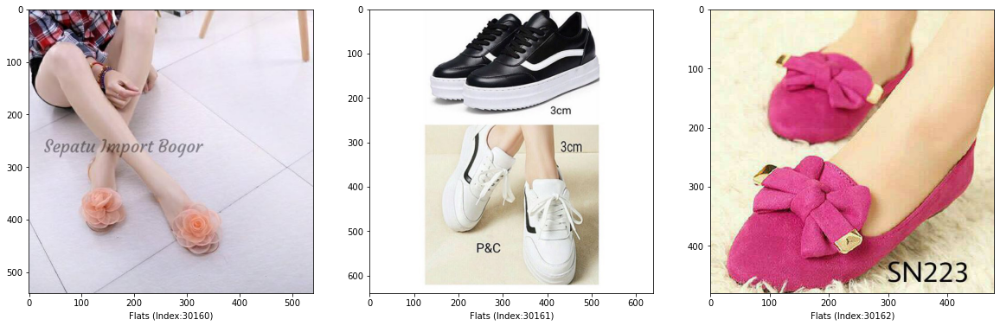

Category 17: Heels


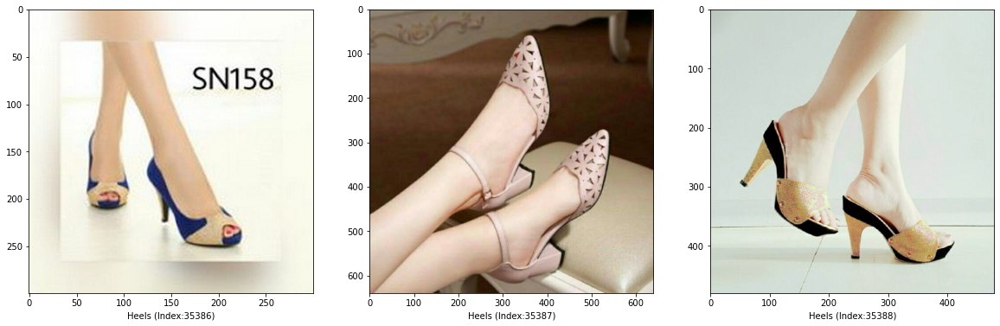

Category 18: Air-conditional


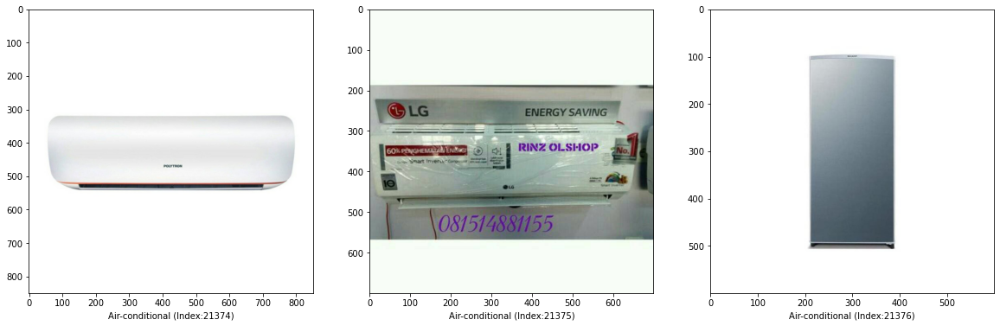

Category 19: Thumbdrives


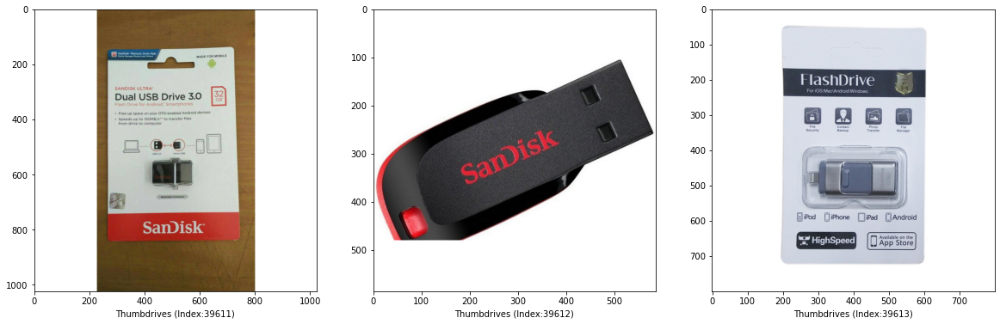

Category 20: Chair


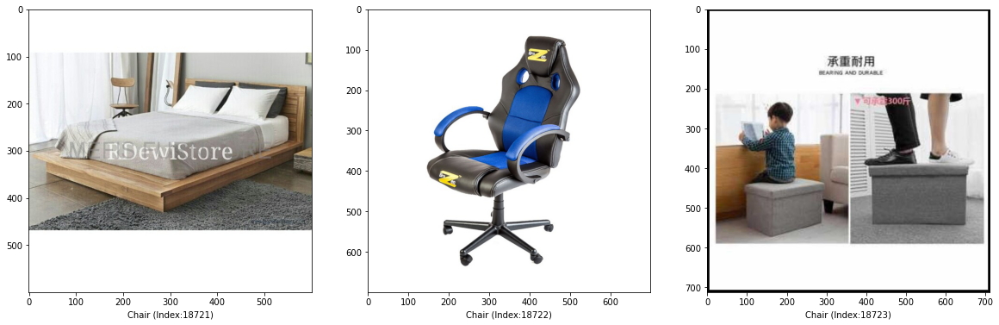

Category 21: Tennis Racket


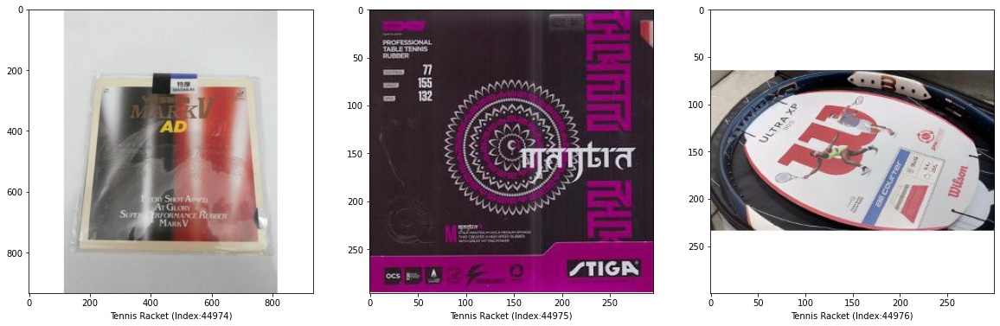

Category 22: Bicycle Helmet


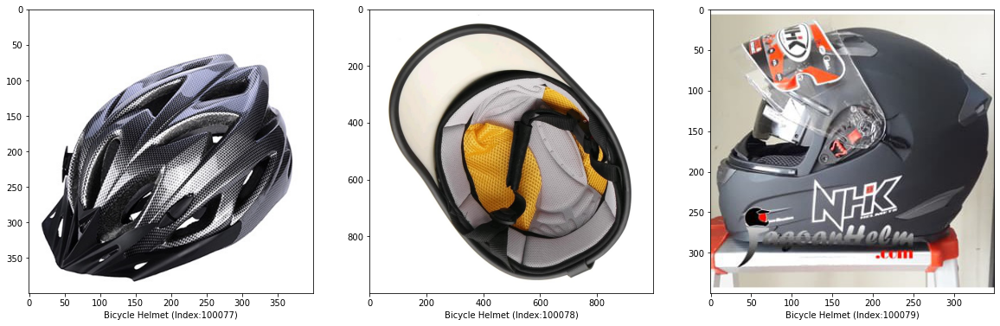

Category 23: Gloves


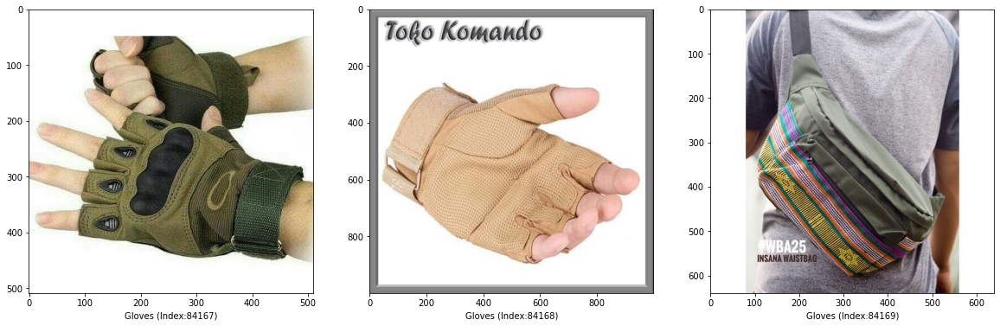

Category 24: Watch


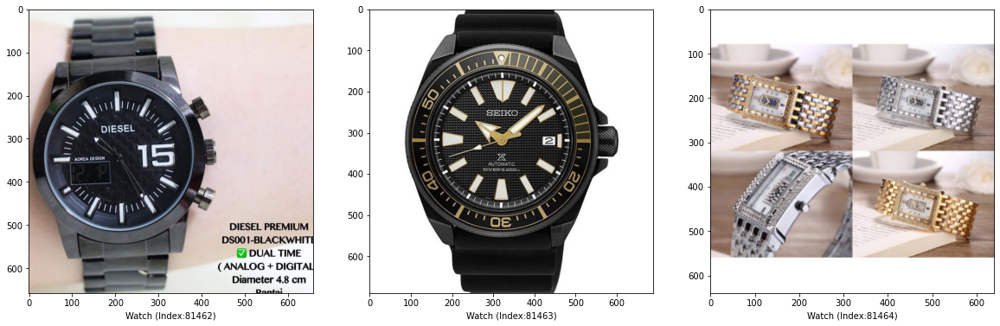

Category 25: Belt


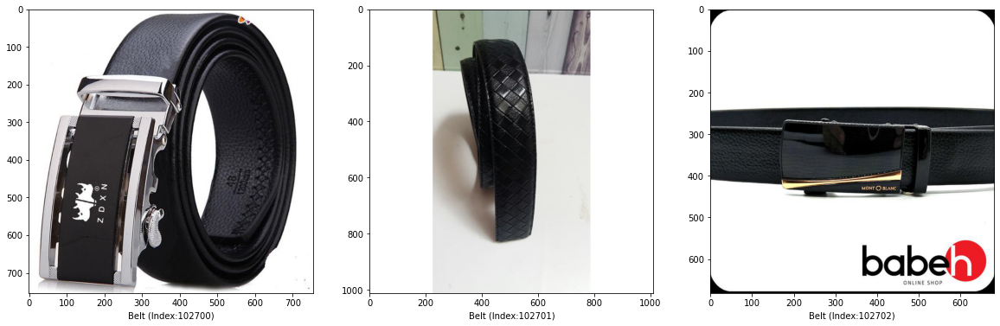

Category 26: Earpiece


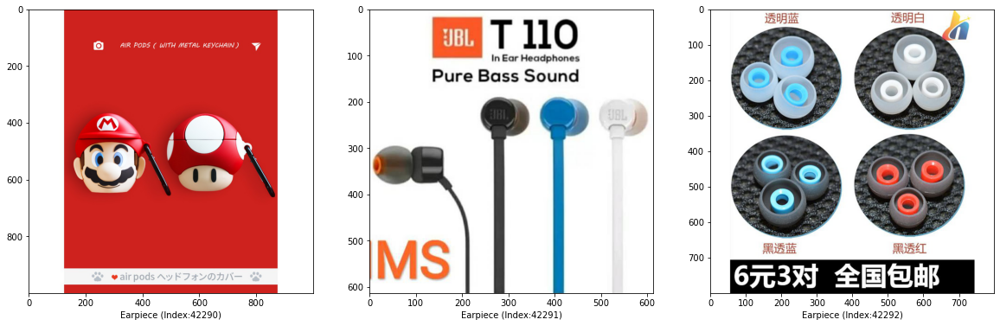

Category 27: Toy Cars


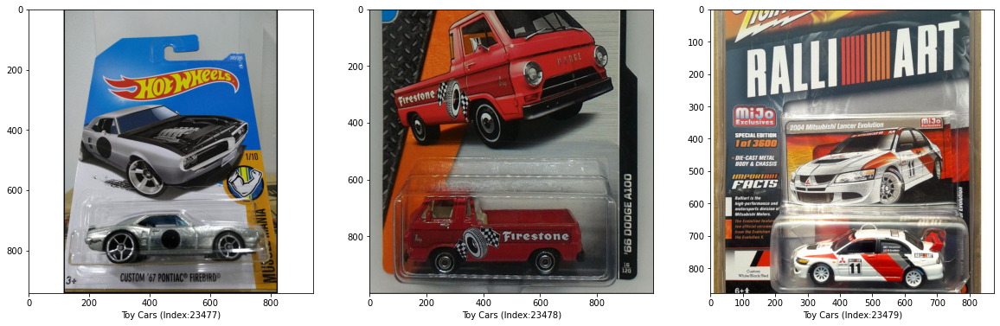

Category 28: Jacket


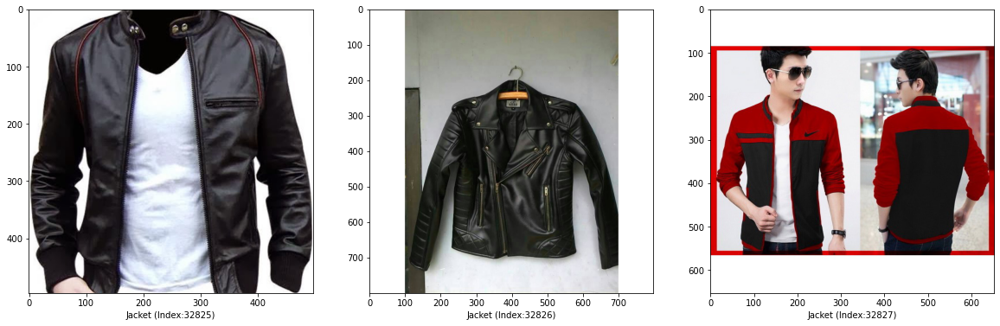

Category 29: Pants


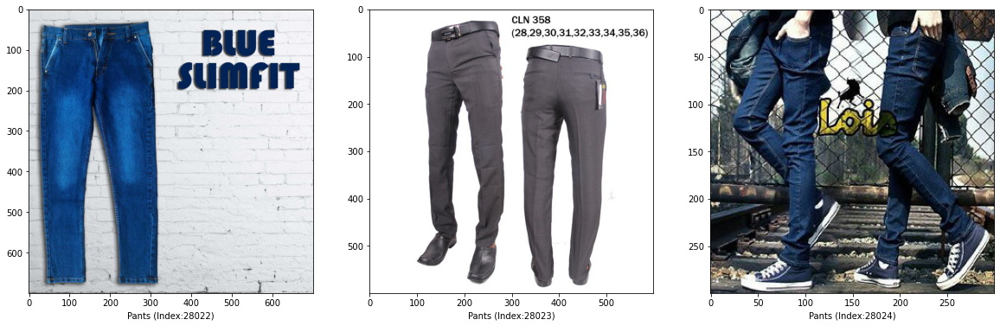

Category 30: Sneakers


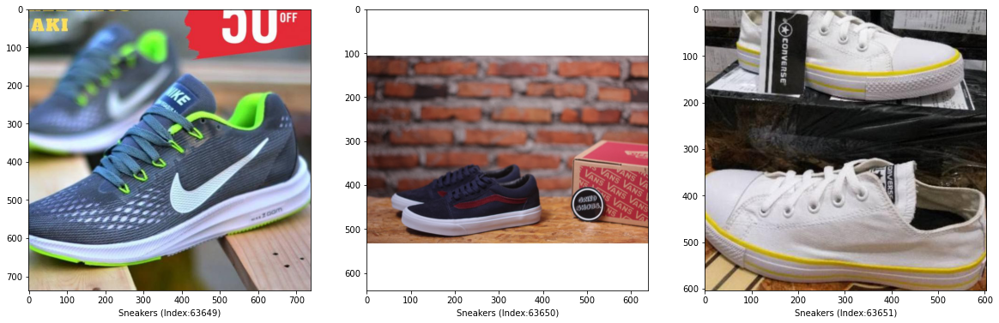

Category 31: Snacks


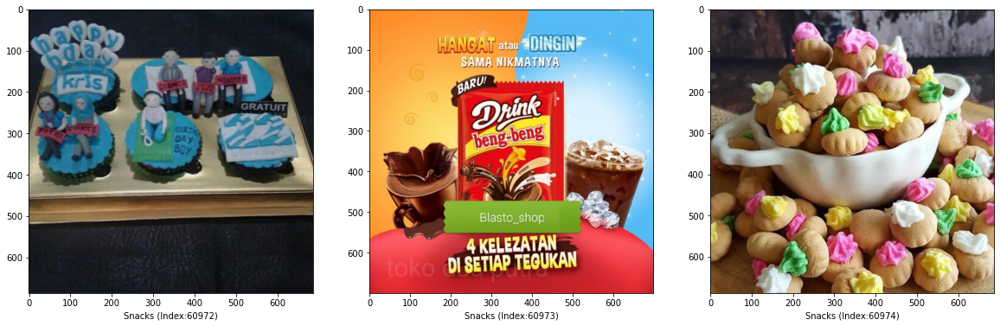

Category 32: Masks


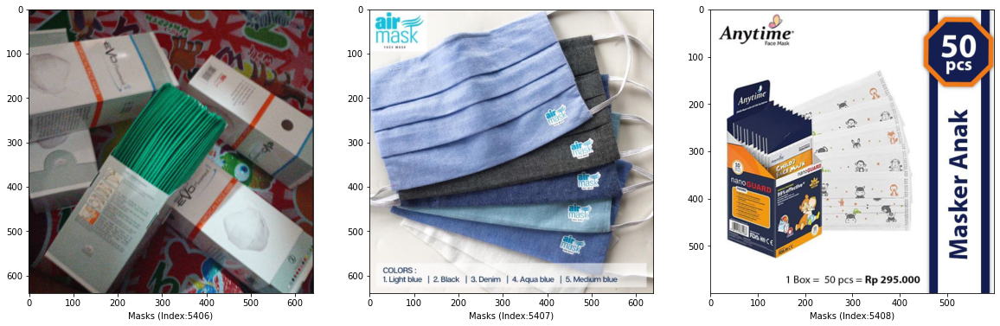

Category 33: Sanitiser


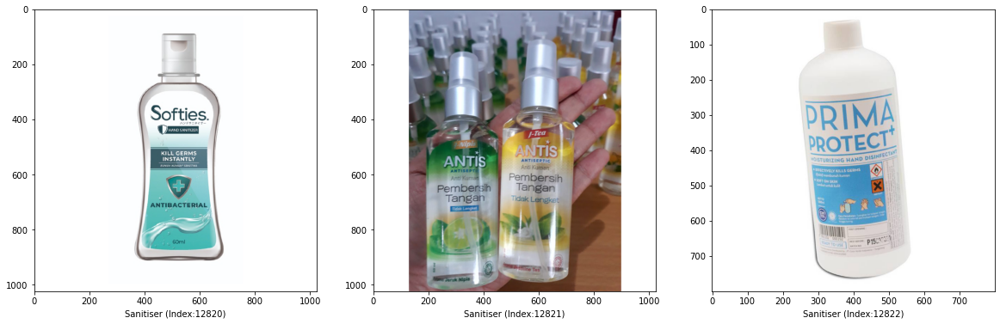

Category 34: Skin Product


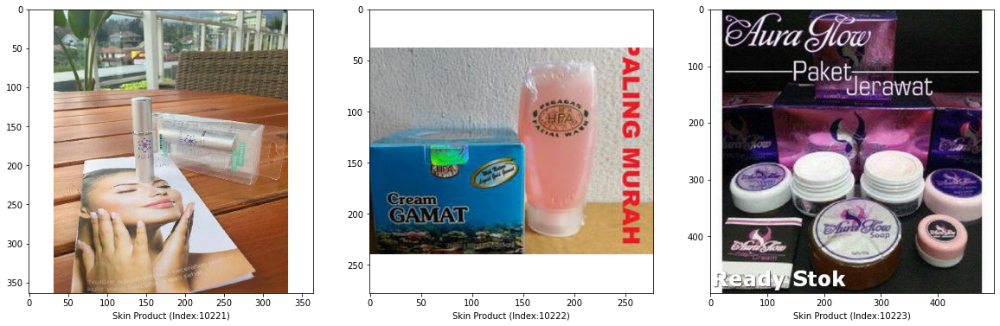

Category 35: Perfume


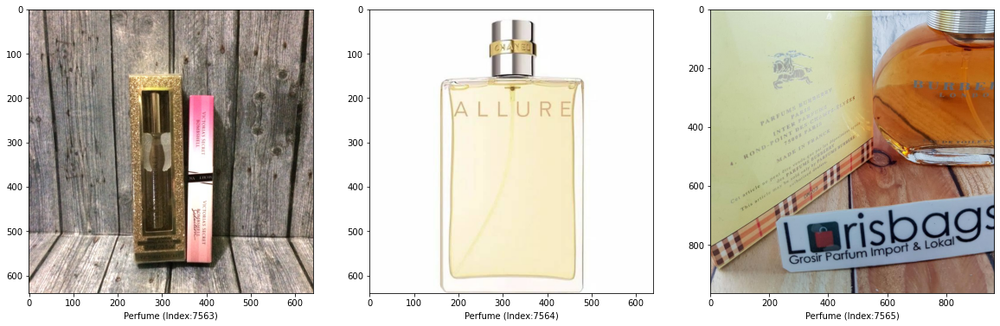

Category 36: Houseware


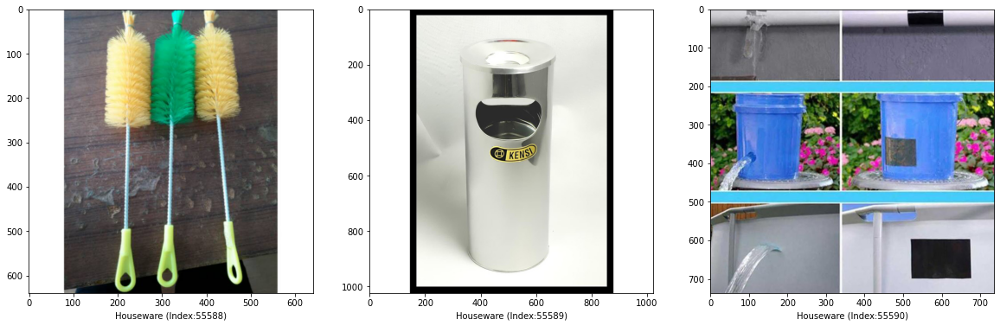

Category 37: Laptop


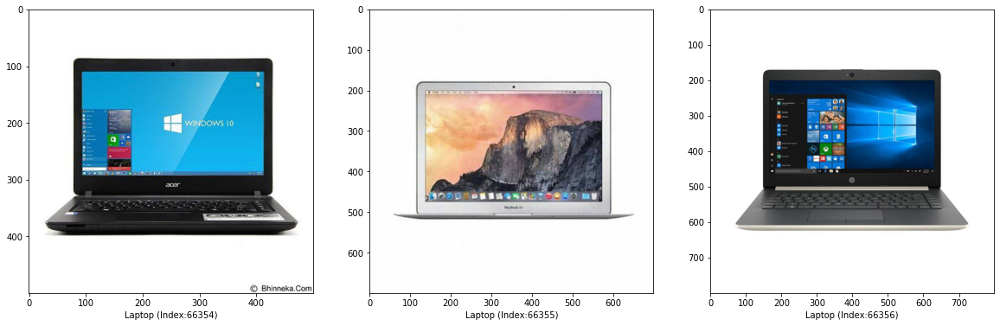

Category 38: Kitchenware


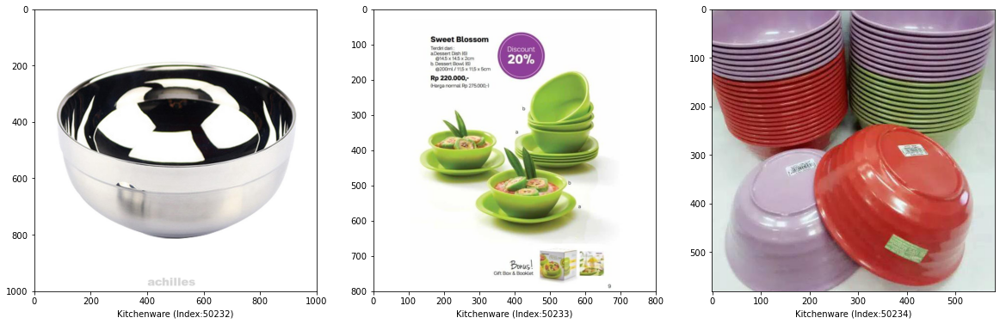

Category 39: Vase


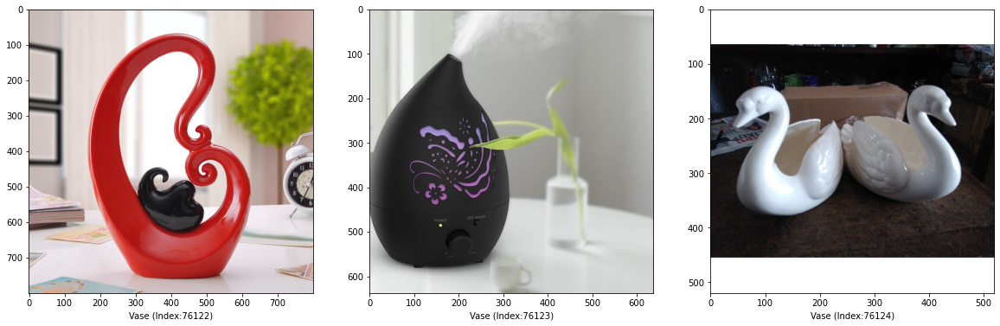

Category 40: Bathroom


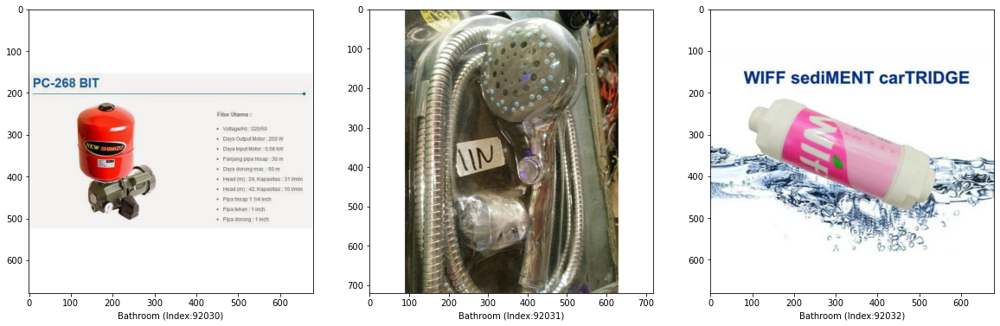

Category 41: Sofa


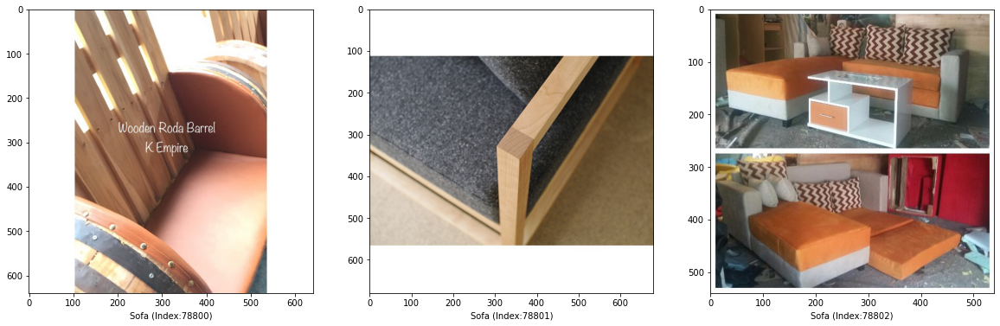

In [17]:
for i in range(0, 42):
    plot_class(i)

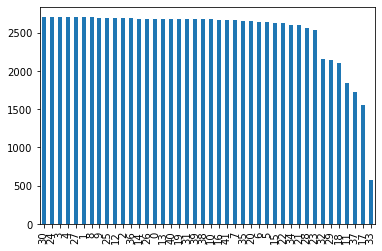

In [18]:
data_train["category"].value_counts().plot.bar()

# 5. Removing Misclassified Images

Removing Misclassified Images did not improve the score so we will leave it

In [19]:
# data_train_new = pd.merge(data_train, detection_list, left_on="filename", right_on="Filename", how="left")

In [20]:
# data_train_new = data_train_new.loc[:,["filename", "category", "temp_category", "image_path", "cat_name", "Status"]]

In [21]:
# data_train_new = data_train_new[data_train_new["Status"] != "Remove"]

In [22]:
# print("{} images were misclassified and removed".format(data_train.shape[0] - data_train_new.shape[0]))

# 6. Train Test Split

In [23]:
train_df, validate_df = train_test_split(data_train, test_size=0.2, random_state=101)
train_df = train_df.reset_index().drop("index", axis=1)
validate_df = validate_df.reset_index().drop("index", axis=1)
total_validate = validate_df.shape[0]
total_train = train_df.shape[0]

In [24]:
train_df.to_csv("train_df.csv")

# 7. Data Transformation

In [25]:
path = os.getcwd()

In [26]:
tfms = get_transforms(do_flip = True, max_lighting = 0.2, max_zoom= 1.1, max_warp = 0.15, max_rotate = 45)
data = ImageDataBunch.from_csv(path,  
                              valid_pct = 0.0,
                              csv_labels = 'train_df.csv',
                              ds_tfms = tfms, 
                              fn_col = 'image_path',
                              #test = 'train_SOaYf6m/images', 
                              label_col = 'temp_category',
                              bs = 15,
                              size = 300).normalize(imagenet_stats)

# 8. Define Learning Rate Function

In [27]:
def find_appropriate_lr(model:Learner, lr_diff:int = 15, loss_threshold:float = .05, adjust_value:float = 1, plot:bool = False) -> float:
    #Run the Learning Rate Finder
    model.lr_find()
    
    #Get loss values and their corresponding gradients, and get lr values
    losses = np.array(model.recorder.losses)
    assert(lr_diff < len(losses))
    loss_grad = np.gradient(losses)
    lrs = model.recorder.lrs
    
    #Search for index in gradients where loss is lowest before the loss spike
    #Initialize right and left idx using the lr_diff as a spacing unit
    #Set the local min lr as -1 to signify if threshold is too low
    r_idx = -1
    l_idx = r_idx - lr_diff
    while (l_idx >= -len(losses)) and (abs(loss_grad[r_idx] - loss_grad[l_idx]) > loss_threshold):
        local_min_lr = lrs[l_idx]
        r_idx -= 1
        l_idx -= 1

    lr_to_use = local_min_lr * adjust_value
    
    if plot:
        # plots the gradients of the losses in respect to the learning rate change
        plt.plot(loss_grad)
        plt.plot(len(losses)+l_idx, loss_grad[l_idx],markersize=10,marker='o',color='red')
        plt.ylabel("Loss")
        plt.xlabel("Index of LRs")
        plt.show()

        plt.plot(np.log10(lrs), losses)
        plt.ylabel("Loss")
        plt.xlabel("Log 10 Transform of Learning Rate")
        loss_coord = np.interp(np.log10(lr_to_use), np.log10(lrs), losses)
        plt.plot(np.log10(lr_to_use), loss_coord, markersize=10,marker='o',color='red')
        plt.show()
        
    return lr_to_use

# 9. Define Function for Testing

In [28]:
def generateSubmission(learn, string, data):
    id_list=list(data["image_path"])
    label=[]
    for iname in id_list:
        img=open_image(iname)
        label.append(learn.predict(img)[0])
        if (len(label)%350 == 0):
            print(f'{len(label)} images done!')
    return label

# 10. Model 1: ResNet50

In [29]:
learn = cnn_learner(data, models.resnet50, metrics=[accuracy], callback_fns=ShowGraph)

In [58]:
find_appropriate_lr(learn)

epoch,train_loss,valid_loss,accuracy,time


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


0.002511886431509582

In [ ]:
# find the correct learning rate to be used from lr finder
#learn.lr_find()
#learn.recorder.plot(suggestion=True)

In [59]:
learn.fit_one_cycle(4, 0.02511886431509582)

In [60]:
# exporting learner
#learn.save("resnet-50", return_path=True)

WindowsPath('D:/shopee-product-detection-dataset/models/resnet-50.pth')

In [30]:
#learn = learn.load("resnet-50")

In [31]:
# unfreeze entire model
learn.unfreeze()

epoch,train_loss,valid_loss,accuracy,time


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.
Min numerical gradient: 3.02E-05
Min loss divided by 10: 1.10E-07


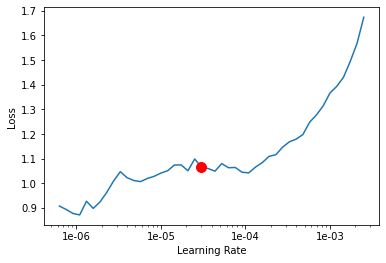

In [33]:
learn.lr_find()
learn.recorder.plot(suggestion=True)

In [34]:
learn.fit_one_cycle(4, slice(3.02e-05, 6e-05), wd=0.15)

In [54]:
# freeze the all layers except last 3 as these are initial layers for finding recurring pattern/shapes/corners etc.
learn.freeze_to(-3)

epoch,train_loss,valid_loss,accuracy,time


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.
Min numerical gradient: 4.79E-06
Min loss divided by 10: 6.31E-08


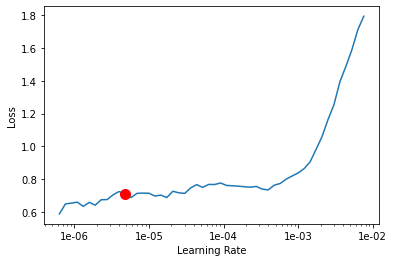

In [55]:
## finding the LR
learn.lr_find()
learn.recorder.plot(suggestion=True)

In [56]:
learn.fit_one_cycle(4, slice(4.79E-06, 5.5e-06), wd=0.1)

In [73]:
# exporting learner
#learn.save("resnet-50", return_path=True)
#learn = learn.load("resnet-50")

WindowsPath('D:/shopee-product-detection-dataset/models/resnet-50.pth')

In [74]:
#learn.export('trained_model.pkl')
#path = learn.path
#learn = load_learner(path, 'trained_model.pkl')

In [75]:
## freezing initial all layers except last 2 layers
learn.freeze_to(-2)

epoch,train_loss,valid_loss,accuracy,time


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.
Min numerical gradient: 1.10E-06
Min loss divided by 10: 3.31E-07


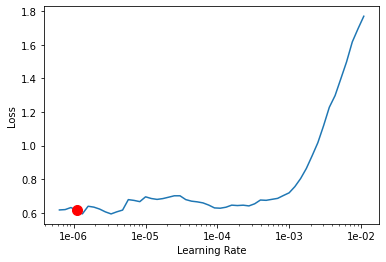

In [76]:
## finding the LR
learn.lr_find()
learn.recorder.plot(suggestion=True)

In [80]:
learn.fit_one_cycle(4, slice(1.10e-06, 1.10e-06/8),wd=0.1)

# 11. Evaluation

In [57]:
validate_df.head()

,filename,category,temp_category,image_path,cat_name,res_50
0,4ae3f534c49aa4eb07ec4f1e50947e32.jpg,31,31,train\train\31\4ae3f534c49aa4eb07ec4f1e50947e3...,Snacks,31
1,b7c7697e4dd25cc92181f66681c867e0.jpg,31,31,train\train\31\b7c7697e4dd25cc92181f66681c867e...,Snacks,31
2,b570827522f6d3aa23e28f8011509e6f.jpg,23,23,train\train\23\b570827522f6d3aa23e28f8011509e6...,Gloves,23
3,da77c00bf729855bf0f058c38ce0672b.jpg,37,37,train\train\37\da77c00bf729855bf0f058c38ce0672...,Laptop,37
4,7d4687d20c8c74419063e0fa3d10dda8.jpg,27,27,train\train\27\7d4687d20c8c74419063e0fa3d10dda...,Toy Cars,27


In [81]:
validate_df['res_50'] = generateSubmission(learn, 'res_50', validate_df)
validate_df['res_50'] = validate_df['res_50'].astype('int')

350 images done!
700 images done!
1050 images done!
1400 images done!
1750 images done!
2100 images done!
2450 images done!
2800 images done!
3150 images done!
3500 images done!
3850 images done!
4200 images done!
4550 images done!
4900 images done!
5250 images done!
5600 images done!
5950 images done!
6300 images done!
6650 images done!
7000 images done!
7350 images done!
7700 images done!
8050 images done!
8400 images done!
8750 images done!
9100 images done!
9450 images done!
9800 images done!
10150 images done!
10500 images done!
10850 images done!
11200 images done!
11550 images done!
11900 images done!
12250 images done!
12600 images done!
12950 images done!
13300 images done!
13650 images done!
14000 images done!
14350 images done!
14700 images done!
15050 images done!
15400 images done!
15750 images done!
16100 images done!
16450 images done!
16800 images done!
17150 images done!
17500 images done!
17850 images done!
18200 images done!
18550 images done!
18900 images done!
1925

In [82]:
validate_df["category"] = validate_df["category"].astype(str)
validate_df["res_50"] = validate_df["res_50"].astype(str)

In [83]:
confusion = pd.DataFrame(confusion_matrix(validate_df["category"], validate_df["res_50"]))

In [84]:
confusion

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41
0,338,130,0,0,0,0,0,1,5,1,0,0,47,2,1,0,2,0,0,0,0,1,1,37,0,0,0,0,0,0,1,0,0,1,4,1,3,0,0,0,2,3
1,109,387,0,0,0,0,0,0,0,0,0,1,10,1,1,0,4,0,1,0,0,1,2,9,0,0,0,0,1,1,2,0,0,0,1,1,2,0,1,0,0,2
2,0,0,484,21,1,0,0,0,1,0,2,2,0,1,1,0,0,0,3,2,1,0,0,0,0,0,0,0,1,1,1,1,1,0,0,0,0,1,0,0,11,2
3,1,0,17,319,0,0,0,0,0,0,8,2,1,0,0,0,1,0,0,1,2,0,1,1,0,0,1,0,1,1,0,4,2,0,0,0,2,0,0,0,1,3
4,0,0,2,1,434,1,2,4,0,0,12,5,0,2,1,3,2,6,1,7,1,0,0,0,1,2,1,0,2,0,4,1,1,6,0,2,13,0,0,0,3,3
5,0,0,2,1,0,447,3,2,1,0,2,0,1,6,0,0,1,0,0,10,0,0,0,0,1,2,4,0,5,3,5,0,12,8,0,6,1,2,2,1,0,2
6,0,0,1,0,1,6,406,5,1,0,11,2,0,3,1,2,0,0,2,4,0,0,0,0,0,1,0,0,0,0,19,1,18,4,1,15,2,2,0,0,0,0
7,0,0,0,1,1,3,4,413,0,0,4,1,0,3,3,0,1,0,0,4,1,0,2,1,2,21,5,0,19,7,14,1,7,10,1,2,3,3,1,3,1,1
8,0,0,0,0,0,0,0,0,452,40,0,0,1,0,1,0,2,0,0,0,0,0,0,1,49,0,1,0,1,2,2,0,0,0,1,0,1,0,0,1,2,1
9,0,0,0,0,0,0,0,0,51,233,0,0,0,0,0,0,1,0,1,0,0,0,0,0,9,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0


In [ ]:
#confusion.to_csv("confusion_matrix.csv")

In [85]:
report = classification_report(validate_df["category"], validate_df["res_50"], output_dict=True)

In [86]:
df_report = pd.DataFrame(report).transpose()

In [88]:
df_report

,precision,recall,f1-score,support
0,0.648752,0.581756,0.613430,581.000000
1,0.720670,0.720670,0.720670,537.000000
10,0.873646,0.899628,0.886447,538.000000
11,0.866848,0.864499,0.865672,369.000000
12,0.929336,0.829828,0.876768,523.000000
13,0.854685,0.843396,0.849003,530.000000
14,0.900222,0.799213,0.846715,508.000000
15,0.808219,0.760589,0.783681,543.000000
16,0.814414,0.810036,0.812219,558.000000
17,0.832143,0.784512,0.807626,297.000000


In [ ]:
#df_report.to_csv("confusion_report.csv")

# 12. Submission

In [90]:
data_test['res_50'] = generateSubmission(learn, 'res_50', data_test)
data_test['res_50'] = data_test['res_50'].astype('int')

350 images done!
700 images done!
1050 images done!
1400 images done!
1750 images done!
2100 images done!
2450 images done!
2800 images done!
3150 images done!
3500 images done!
3850 images done!
4200 images done!
4550 images done!
4900 images done!
5250 images done!
5600 images done!
5950 images done!
6300 images done!
6650 images done!
7000 images done!
7350 images done!
7700 images done!
8050 images done!
8400 images done!
8750 images done!
9100 images done!
9450 images done!
9800 images done!
10150 images done!
10500 images done!
10850 images done!
11200 images done!
11550 images done!
11900 images done!


In [91]:
data_test.head()

,filename,category,image_path,res_50
0,fd663cf2b6e1d7b02938c6aaae0a32d2.jpg,43,test\test\fd663cf2b6e1d7b02938c6aaae0a32d2.jpg,20
1,c7fd77508a8c355eaab0d4e10efd6b15.jpg,43,test\test\c7fd77508a8c355eaab0d4e10efd6b15.jpg,27
2,127f3e6d6e3491b2459812353f33a913.jpg,43,test\test\127f3e6d6e3491b2459812353f33a913.jpg,4
3,5ca4f2da11eda083064e6c36f37eeb81.jpg,43,test\test\5ca4f2da11eda083064e6c36f37eeb81.jpg,22
4,46d681a542f2c71be017eef6aae23313.jpg,43,test\test\46d681a542f2c71be017eef6aae23313.jpg,12


In [92]:
submission = data_test.loc[:,["filename", "res_50"]]

In [93]:
submission.columns = ["filename", "category"]

In [94]:
submission["category"] = submission["category"].astype(str)

In [95]:
submission["category"] = submission["category"].apply(lambda x: "0" + x if len(x)==1 else x)

In [96]:
submission.head()

,filename,category
0,fd663cf2b6e1d7b02938c6aaae0a32d2.jpg,20
1,c7fd77508a8c355eaab0d4e10efd6b15.jpg,27
2,127f3e6d6e3491b2459812353f33a913.jpg,04
3,5ca4f2da11eda083064e6c36f37eeb81.jpg,22
4,46d681a542f2c71be017eef6aae23313.jpg,12


In [97]:
submission.to_csv("submission_resnet50.csv", index=False)